In [1]:
import numpy as np
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import pandas as pd
import random
import matplotlib.pyplot as plt
import plotly.express as px
import matplotlib.colors as mcolors
from tqdm import tqdm
from IPython.display import clear_output


In [2]:
def optimal_transition_function(position,velocity,action_input = None, N=1):
    ''' 
    Input: Start state (position, velocity) 
    Output: Optimal N step trajectory given the start state 
    Trajectory = [position, velocity, next_position, next_velocity, reward, action] (S,A,S',R) * N
    '''
    trajectory = [] 
    for i in range(N):
        action = -1 if velocity < 0 else 1 #Optimal Policy
        if action_input is not None:
            action = action_input
        next_velocity = velocity + (0.001 * action - 0.0025 * np.cos(3 * position))
        next_velocity = np.clip(next_velocity, -0.07, 0.07)
        next_position = position + next_velocity
        next_position = np.clip(next_position, -1.2, 0.6)
        if (next_position == -1.2 and next_velocity < 0): next_velocity = 0
        reward = -(next_position - 0.5) ** 2
        trajectory.append(torch.tensor([position, velocity,next_position, next_velocity, reward, action], dtype=torch.float32))
        position = next_position
        velocity = next_velocity
    return trajectory

#Get a bunch of trajectories for a range of start states. Split train/test
def get_data(n,position_count,velocity_count):
    positions = np.linspace(-1.2,0.4,position_count)
    velocities = np.linspace(-0.07,0.07,velocity_count)
    all_data = []
    for position in positions:
        for velocity in velocities:
            trajectory = optimal_transition_function(position,velocity,N=n)
            all_data.append(trajectory)

    #all_data = np.array(all_data)
    np.random.shuffle(all_data)
    train_len = int(0.8 * len(all_data))
    train_data = all_data[:train_len]
    test_data = all_data[train_len:]
    print(f"Train data size: {len(train_data)} | Test data size: {len(test_data)}")
    print(f"Train data shape: {len(train_data[0])} | Test data shape: {len(test_data[0])}")
    return train_data, test_data


In [3]:
action_sequences = list(product(ACTIONS, repeat=N))
print(f"Action sequences: {action_sequences}")

NameError: name 'product' is not defined

In [4]:
import numpy as np
import torch
from itertools import product

ACTIONS = [-1, 1]

def all_transition_trajectories(position, velocity, N=1):
    """
    Input: Start state (position, velocity)
    Output: All N-step trajectories with all possible action combinations
    """
    all_trajectories = []

    # Generate all action sequences of length N
    action_sequences = list(product(ACTIONS, repeat=N))

    for action_seq in action_sequences:
        pos = position
        vel = velocity
        trajectory = []

        for action in action_seq:
            next_velocity = vel + (0.001 * action - 0.0025 * np.cos(3 * pos))
            next_velocity = np.clip(next_velocity, -0.07, 0.07)
            next_position = pos + next_velocity
            next_position = np.clip(next_position, -1.2, 0.6)
            if next_position == -1.2 and next_velocity < 0:
                next_velocity = 0
            reward = -(next_position - 0.5) ** 2
            transition = torch.tensor([pos, vel, next_position, next_velocity, reward, action], dtype=torch.float32)
            trajectory.append(transition)
            pos = next_position
            vel = next_velocity

        all_trajectories.append(trajectory)

    return all_trajectories


def get_data(n, position_count, velocity_count):
    positions = np.linspace(-1.2, 0.4, position_count)
    velocities = np.linspace(-0.07, 0.07, velocity_count)
    all_data = []

    for position in positions:
        for velocity in velocities:
            trajectories = all_transition_trajectories(position, velocity, N=n)
            all_data.extend(trajectories)

    np.random.shuffle(all_data)
    train_len = int(0.8 * len(all_data))
    train_data = all_data[:train_len]
    test_data = all_data[train_len:]
    print(f"Train data size: {len(train_data)} | Test data size: {len(test_data)}")
    print(f"Train trajectory length: {len(train_data[0])} | Test trajectory length: {len(test_data[0])}")
    return train_data, test_data


In [5]:
##The model, softmaxes at the end for probability representation
class StateEncoder(nn.Module): 
    # 2 -> discrete_states  
    def __init__(self, discrete_states):
        super(StateEncoder, self).__init__()
        self.fc1 = nn.Linear(2, discrete_states//2)
        self.fc2 = nn.Linear(discrete_states//2, discrete_states)
        self.fc3 = nn.Linear(discrete_states, discrete_states)
        self.fc4 = nn.Linear(discrete_states, discrete_states)


    def forward(self, x):
        x = F.relu(self.fc1(x))
        # Softmax final layer 
        x = F.relu(self.fc2(x))
        x = F.relu(self.fc3(x))
        x = F.softmax(self.fc4(x), dim=0) # Softmax to get probabilities
        return x

# Normalize transition matrix before calculation
####Most Complicated Part###@@@@#############################################################################################
#############################################################################################################################
class TransitionModel(nn.Module):
    def __init__(self, discrete_states):
        super(TransitionModel, self).__init__()
        self.state_encoder = StateEncoder(discrete_states) 
        self.transition_matrix = nn.Parameter(torch.rand(2, discrete_states, discrete_states)) #2 actions, then discrete_states x discrete_states
        self.state_decoder = nn.Parameter(torch.rand(2, discrete_states))
        self.reward_decoder = nn.Parameter(torch.rand(2,discrete_states)) #2 actions, 1 reward for each latent state

    #Trajectory is [[curr_pos,curr_velocity,next_pos,next_velocity,reward,action], ... N]
    def forward(self, trajectory):
        curr_state = trajectory[0][:2]
        curr_latent_state_probabilities = self.state_encoder(curr_state) 
        predicted_latent_state_probabilities = [curr_latent_state_probabilities] #Initialize with the first state

        #We predict N timesteps ahead in latent space
        for timestep in trajectory:  # Really all we need here are the actions to index the transition matrix using the optimal action
            action = int(timestep[5]) 
            action = 0 if action == -1 else 1 #convert -1,1 actions to indexes of the transition matrix
            # Transition step
            predicted_next_latent_state_probabilities = torch.matmul(F.softmax(self.transition_matrix[action], dim=0), curr_latent_state_probabilities) #softmaxing the transition matrix
            predicted_latent_state_probabilities.append(predicted_next_latent_state_probabilities)
            curr_latent_state_probabilities = predicted_next_latent_state_probabilities
        return predicted_latent_state_probabilities #Return N-1 latent states probabilities

    # def forward_plan(self, initial_state):
    #     curr_latent_state_probabilities = self.state_encoder(initial_state) 
    
def train(model, optimizer, train_data, test_data, epochs, N, auto_weight=1, transition_weight=1, decode_weight=1):
    train_losses = []
    transition_losses = []
    decode_losses = []
    auto_encode_losses = []
    total_reward_losses = []


    for epoch in range(epochs):
        total_train_loss = 0.0
        total_transition_loss = 0.0
        total_decode_loss = 0.0
        total_auto_encode_loss = 0.0
        total_reward_loss = 0.0

        # Shuffle training data
        epoch_data = random.sample(train_data, len(train_data))

        for i in range(len(epoch_data)):
            trajectory = epoch_data[i]
            optimizer.zero_grad()
            predicted_latent_state_probabilities = model(trajectory)

            true_next_states = torch.stack([trajectory[i][2:4] for i in range(N)])
            true_initial_states = torch.stack([trajectory[0][:2] for _ in range(N)])
            next_latent_state_probabilities = torch.stack([model.state_encoder(trajectory[i][2:4]) for i in range(N)])

            eps = 1e-8
            transition_loss = transition_weight * sum(
                F.kl_div((next_latent_state_probabilities[i] + eps).log(), predicted_latent_state_probabilities[i], reduction="mean")
                for i in range(1, N)
            )

            decode_loss = decode_weight * sum(
                (torch.einsum('x,xs->s', predicted_latent_state_probabilities[i], (model.state_decoder.T - true_next_states[i])**2)*torch.tensor([1,11])).sum()
                for i in range(1, N)
            )

            auto_encode_decoder_loss = auto_weight * sum(
                (torch.einsum('x,xs->s', predicted_latent_state_probabilities[i], (model.state_decoder.T - true_initial_states[i])**2)*torch.tensor([1,11])).sum()
                for i in range(N-1)
            )

            rewards = torch.stack([trajectory[i][4] for i in range(N)])
            actions = torch.stack([trajectory[i][5] for i in range(N)])
            #convert actions to 0,1
            #actions = torch.where(actions == -1, torch.tensor(0.0), torch.tensor(1.0))
            reward_loss = torch.tensor(0.0)
            for i in range(N):
                action = int(actions[i])
                action = 0 if action == -1 else 1 #convert -1,1 actions to indexes of the transition matrix
                for j in range(len(predicted_latent_state_probabilities[i])): 
                    reward_loss += predicted_latent_state_probabilities[i][j] * (model.reward_decoder[action][j] - rewards[i])**2


            loss = decode_loss + auto_encode_decoder_loss + transition_loss + reward_loss
            loss.backward()
            optimizer.step()

            total_train_loss += loss.item()
            total_transition_loss += transition_loss.item()
            total_decode_loss += decode_loss.item()
            total_auto_encode_loss += auto_encode_decoder_loss.item()
            total_reward_loss += reward_loss.item()

        # Store losses
        train_losses.append(total_train_loss / len(train_data))
        transition_losses.append(total_transition_loss / len(train_data))
        decode_losses.append(total_decode_loss / len(train_data))
        auto_encode_losses.append(total_auto_encode_loss / len(train_data))
        total_reward_losses.append(total_reward_loss / len(train_data))

        # Clear and print updated loss info
        clear_output(wait=True)
        print(f"Epoch {epoch+1}/{epochs}")
        print(f"Train Loss:         {train_losses[-1]:.6f}")
        print(f"Transition Loss:    {transition_losses[-1]:.6f}")
        print(f"Decode Loss:        {decode_losses[-1]:.6f}")
        print(f"Auto Encode Loss:   {auto_encode_losses[-1]:.6f}")
        print(f"Reward Loss:        {total_reward_losses[-1]:.6f}")
    # Final plot
    plt.figure(figsize=(10, 4))
    plt.plot(train_losses, label="Total Train Loss")
    plt.plot(decode_losses, label="Decode Loss")
    plt.plot(auto_encode_losses, label="Auto Encode Loss")
    plt.plot(transition_losses, label="Transition Loss")
    plt.plot(total_reward_losses, label="Reward Loss")
    plt.title("Training Losses Over Epochs")
    plt.xlabel("Epoch")
    plt.ylabel("Loss")
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()


        # Testing loop with tqdm
        # with torch.no_grad():
        #     for i in tqdm(range(len(test_data)), desc=f"Testing Epoch {epoch+1}", leave=False, unit="batch"):
        #         trajectory = test_data[i]
        #         predicted_latent_states = model(trajectory)
        #         true_initial_states = torch.stack([trajectory[0][:2] for _ in range(N)])
        #         true_next_states = torch.stack([trajectory[i][2:4] for i in range(N)])
        #         encoded_next_states = torch.stack([model.state_encoder(trajectory[i][2:4]) for i in range(N)])

        #         transition_loss = sum(F.kl_div(predicted_latent_states[i].log(), encoded_next_states[i], reduction="batchmean") for i in range(len(predicted_latent_states)))

        #         decode_loss = sum(
        #             torch.einsum('x,xs->s', predicted_latent_states[i], (model.state_decoder.T - true_next_states[i])**2).sum()
        #             for i in range(len(predicted_latent_states))
        #         )

        #         loss = transition_loss + decode_loss
        #         total_test_loss += loss.item()

        #     test_losses.append(total_test_loss / len(test_data))

    # plt.plot(train_losses)
    # #plt.plot(test_losses[2:])
    # #plt.legend(["Train Loss", "Test Loss"])
    # plt.title("Results")
    # plt.show()
####END Most Complicated Part###@@@@##############################################################################################
##################################################################################################################################

In [6]:
def get_colormap(discrete_states):
    if discrete_states <= 10:
        return plt.get_cmap('tab10', discrete_states)
    elif discrete_states <= 20:
        return plt.get_cmap('tab20', discrete_states)
    else:
        return plt.get_cmap('gist_ncar', discrete_states)

def plot_categorical_states(train_data, tmodel, discrete_states):
    argmax_states = []
    alphas = []

    for i in train_data: 
        state = torch.tensor(i[0][:2]).clone().detach().float()
        probabilities = tmodel.state_encoder(state)
        argmax_value = probabilities.argmax().item()
        max_prob = probabilities.max().item()

        argmax_states.append([np.array(state), argmax_value])
        alphas.append(max_prob)

    x = np.array([s[0][0] for s in argmax_states])
    y = np.array([s[0][1] for s in argmax_states])
    colors = np.array([s[1] for s in argmax_states])
    alphas = np.array(alphas)

    cmap = get_colormap(discrete_states)
    norm = mcolors.Normalize(vmin=0, vmax=discrete_states-1)

    fig, axs = plt.subplots(1, 2, figsize=(12, 5))

    scatter1 = axs[0].scatter(x, y, c=colors, cmap=cmap, norm=norm, edgecolors='k', alpha=alphas)
    axs[0].set_title("Alpha = Max Probability")
    fig.colorbar(scatter1, ax=axs[0], label="Argmax Category", ticks=range(discrete_states))

    scatter2 = axs[1].scatter(x, y, c=colors, cmap=cmap, norm=norm, edgecolors='k')
    axs[1].set_title("Alpha = 1 (Constant)")
    fig.colorbar(scatter2, ax=axs[1], label="Argmax Category", ticks=range(discrete_states))

    plt.tight_layout()
    plt.show()

def plot_categorical_states_plotly(train_data, tmodel, discrete_states):
    argmax_states = []
    alphas = []
    max_probs = []

    for i in train_data: 
        state = torch.tensor(i[0][:2]).clone().detach().float()
        probabilities = tmodel.state_encoder(state)
        argmax_value = probabilities.argmax().item()
        max_prob = probabilities.max().item() 

        argmax_states.append([np.array(state), argmax_value])
        alphas.append(max_prob)
        max_probs.append(max_prob)

    df = pd.DataFrame({
        "x": [s[0][0] for s in argmax_states],
        "y": [s[0][1] for s in argmax_states],
        "argmax": [s[1] for s in argmax_states],
        "max_prob": max_probs,
        "alpha": alphas
    })

    all_categories = list(range(discrete_states))
    cmap = get_colormap(discrete_states)

    color_map = {str(i): f"rgb{tuple(int(255 * c) for c in cmap(i / max(1, discrete_states - 1))[:3])}"
                 for i in all_categories}

    df["argmax"] = df["argmax"].astype(str)

    fig = px.scatter(
        df, x="x", y="y", color="argmax", color_discrete_map=color_map,
        opacity=df["alpha"], hover_data={"x": True, "y": True, "argmax": True, "max_prob": True},
        category_orders={"argmax": [str(i) for i in all_categories]}
    )

    fig.update_layout(title="2D State Plot with Argmax as Color", xaxis_title="Position", yaxis_title="Velocity")
    fig.show()
    
def do_all(train_data,test_data,discrete_states, learning_rate, epochs,N, auto_weight, transition_weight, decode_weight):
    tmodel = TransitionModel(discrete_states)
    optimizer = optim.Adam(tmodel.parameters(), lr=learning_rate)
    train(tmodel, optimizer, train_data, test_data, epochs, N,auto_weight, transition_weight, decode_weight)
    plot_categorical_states(train_data, tmodel, discrete_states)
    plot_categorical_states_plotly(train_data, tmodel,  discrete_states)
    return tmodel

def print_model(model):
    print("Transition Matrix Action 0")
    print(np.round(F.softmax(model.transition_matrix[0],dim=0).detach().numpy(), 2))
    print("Model Decoder")
    print(np.round(model.state_decoder.detach().numpy(), 2))

def print_example(model, test_data):
    sample_trajectory = test_data[0]
    print("Sample trajectory:")
    print(sample_trajectory)
    output = model(sample_trajectory)
    print("Output:")
    print(output)
    decoded_states = []
    for i in range(len(output)):
        decoded_state = torch.matmul(model.state_decoder, output[i])
        decoded_states.append(decoded_state)
    print("Decoded states:")
    print(decoded_states)
    true_next_states = torch.stack([sample_trajectory[i][2:4] for i in range(len(sample_trajectory))])
    print("True next states:")
    print(true_next_states)

In [7]:
#Use all actions

In [8]:
N = 3
train_data, test_data = get_data(N,50,50)

Train data size: 16000 | Test data size: 4000
Train trajectory length: 3 | Test trajectory length: 3


Epoch 4/4
Train Loss:         0.162850
Transition Loss:    0.040899
Decode Loss:        0.033016
Auto Encode Loss:   0.034422
Reward Loss:        0.054513


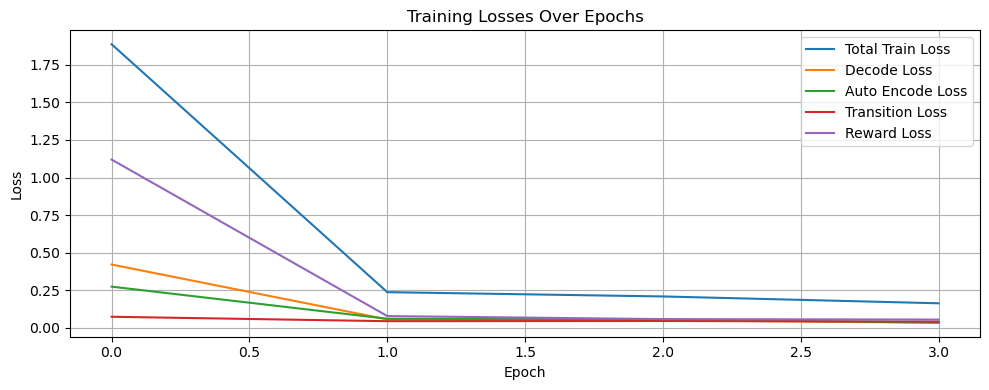

Transition Matrix Action 0
[[1.   0.   0.   ... 0.03 0.   0.  ]
 [0.   0.99 0.   ... 0.   0.   0.  ]
 [0.   0.   0.06 ... 0.   0.   0.  ]
 ...
 [0.   0.   0.   ... 0.95 0.   0.  ]
 [0.   0.   0.   ... 0.   1.   0.  ]
 [0.   0.   0.   ... 0.   0.   0.98]]
Model Decoder
[[-0.21 -0.53 -0.85 -0.36 -0.72  0.12 -0.73 -0.18 -0.34 -0.84 -0.    0.27
  -0.65 -0.8  -0.28 -0.51 -0.84 -0.37 -0.79 -0.72 -0.9  -0.74 -0.82 -0.73
  -0.74 -0.84 -0.39 -1.15 -0.35 -1.07 -0.11  0.06 -0.73 -0.84 -0.65 -0.38
  -0.89 -0.44 -0.13 -0.52 -0.3  -0.51 -0.95 -0.27 -0.44 -0.85 -0.84 -0.3
   0.29 -0.78]
 [ 0.02  0.03  0.   -0.05 -0.03 -0.04  0.03 -0.03 -0.02  0.04  0.03 -0.04
  -0.03 -0.06 -0.01 -0.05  0.   -0.02  0.04  0.02 -0.03 -0.03 -0.02  0.01
   0.01  0.04  0.06 -0.02 -0.02  0.02  0.04  0.01  0.01  0.04  0.04  0.05
   0.05 -0.05 -0.05 -0.05 -0.05  0.03 -0.01 -0.01 -0.05  0.03  0.04  0.05
   0.04 -0.03]]
Sample trajectory:
[tensor([-0.9388, -0.0586, -0.9960, -0.0572, -2.2380, -1.0000]), tensor([-0.9960, -0.0572,

C:\Users\mikef\AppData\Local\Temp\ipykernel_12540\1917950421.py:14: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  state = torch.tensor(i[0][:2]).clone().detach().float()


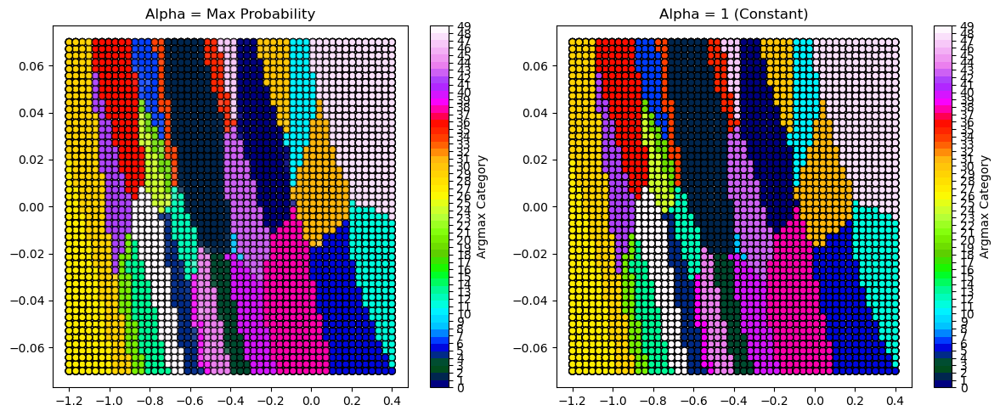

C:\Users\mikef\AppData\Local\Temp\ipykernel_12540\1917950421.py:49: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  state = torch.tensor(i[0][:2]).clone().detach().float()


In [9]:
#t loss IS  in total loss
discrete_states = 50
learning_rate = 0.001
epochs = 4
auto_weight = 1
transition_weight = 1
decode_weight = 1

tmodel = TransitionModel(discrete_states)
optimizer = optim.Adam(tmodel.parameters(), lr=learning_rate)
train(tmodel, optimizer, train_data, test_data, epochs,N,auto_weight, transition_weight, decode_weight)
print_model(tmodel)
print_example(tmodel, test_data)
plot_categorical_states(train_data, tmodel, discrete_states)
plot_categorical_states_plotly(train_data, tmodel, discrete_states)

C:\Users\mikef\AppData\Local\Temp\ipykernel_12540\1917950421.py:14: UserWarning:

To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).



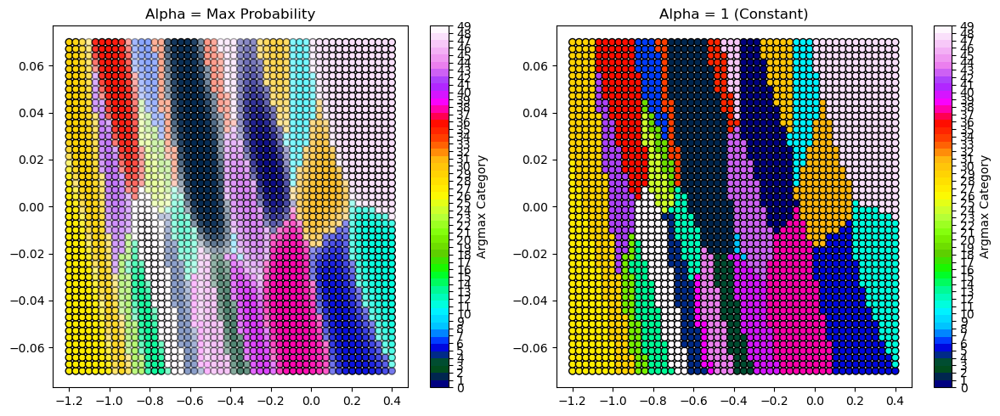

In [10]:
unique_starting_states = []
positions = np.linspace(-1.2,0.4,50)
velocities = np.linspace(-0.07,0.07,50)
for position in positions:
    for velocity in velocities:
        unique_starting_states.append(torch.tensor([[position, velocity]], dtype=torch.float32))
#unique_starting_states = torch.stack(unique_starting_states)
plot_categorical_states(unique_starting_states, tmodel, discrete_states)


In [ ]:
#save tmodel
#torch.save(tmodel.state_dict(), "tmodel.pth")


C:\Users\mikef\AppData\Local\Temp\ipykernel_12540\2915540351.py:8: UserWarning:

To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).



21
21
[[-0.5         0.        ]
 [-0.52515185  0.03032644]
 [-0.52515185  0.03032644]
 [-0.52515185  0.03032644]
 [-0.52515185  0.03032644]
 [-0.52515185  0.03032644]
 [-0.52515185  0.03032644]
 [-0.52515185  0.03032644]
 [-0.52515185  0.03032644]
 [-0.52515185  0.03032644]
 [-0.52515185  0.03032644]
 [-0.52515185  0.03032644]
 [-0.52515185  0.03032644]
 [-0.52515185  0.03032644]
 [-0.52515185  0.03032644]
 [-0.52515185  0.03032644]
 [-0.2833571  -0.01478932]
 [-0.27321488 -0.01227661]
 [-0.27321488 -0.01227661]
 [-0.27321488 -0.01227661]
 [-0.27321488 -0.01227661]]


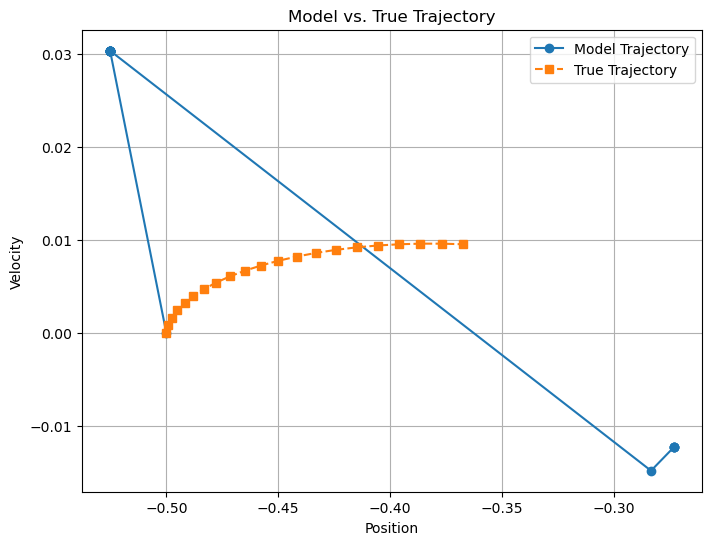

In [11]:
def test_trajectory(model, initial_state, num_steps):
    state = initial_state
    #print(state)
    model_trajectory = [state]
    true_trajectory = [state]
    for i in range(num_steps):
        action = 0 if state[1].item() < 0 else 1
        enc_state = model.state_encoder(torch.tensor(state, dtype=torch.float32)).detach()
        model_next_state_probabilities = torch.matmul(model.transition_matrix[action], enc_state).detach()
        #decode state is decoder[model_next_state.argmax]
        model_trajectory.append(model.state_decoder[:,model_next_state_probabilities.argmax()].detach().numpy())
        true_next_state = optimal_transition_function(state[0].item(), state[1].item(), action_input=action, N=1)[0][2:4]
        true_trajectory.append(true_next_state.detach().numpy())
        state = true_next_state


        
    #graph real vs true
    # print(model_trajectory[0])
    # print(model_trajectory[1])
    # print(model.state_decoder.shape)
    print(len(model_trajectory))
    print(len(true_trajectory))
    model_trajectory = np.array(model_trajectory)
    true_trajectory = np.array(true_trajectory)
    print(model_trajectory)
    plt.figure(figsize=(8, 6))
    plt.plot(model_trajectory[:, 0], model_trajectory[:, 1], label="Model Trajectory", marker="o")
    plt.plot(true_trajectory[:, 0], true_trajectory[:, 1], label="True Trajectory", marker="s", linestyle="dashed")
    plt.xlabel("Position")
    plt.ylabel("Velocity")
    plt.title("Model vs. True Trajectory")
    plt.legend()
    plt.grid()
    plt.show()

random_initial_state = torch.tensor([-0.5, 0.0], dtype=torch.float32)
test_trajectory(tmodel, random_initial_state, 20)

In [14]:
print(((torch.softmax(tmodel.transition_matrix[0], dim=0).detach().numpy()) > 0.9).sum()/discrete_states)
print(((torch.softmax(tmodel.transition_matrix[1], dim=0).detach().numpy()) > 0.9).sum()/discrete_states)

0.4
0.4


Epoch 50/50
Train Loss:         0.089674
Transition Loss:    0.023930
Decode Loss:        0.017075
Auto Encode Loss:   0.018379
Reward Loss:        0.030291


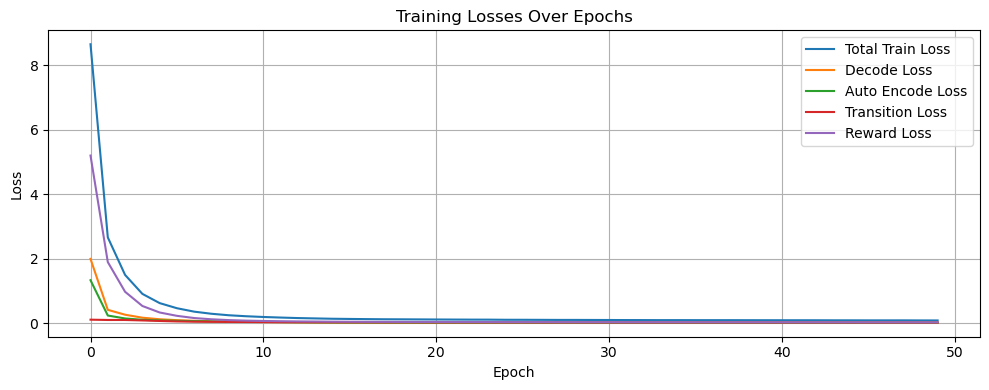

Transition Matrix Action 0
[[0.   0.   0.   ... 0.   0.   0.  ]
 [0.   0.04 0.   ... 0.   0.   0.  ]
 [0.   0.01 0.   ... 0.06 0.   0.99]
 ...
 [0.   0.   0.   ... 0.02 0.   0.  ]
 [0.   0.   0.   ... 0.   0.   0.  ]
 [0.   0.   0.   ... 0.06 0.   0.01]]
Model Decoder
[[-0.26 -1.05 -0.74  0.02 -0.5  -0.32  0.27  0.02 -1.15  0.05 -0.94 -0.34
  -0.94 -0.57 -1.01 -0.54 -0.08 -0.26 -0.41 -0.19 -0.68  0.31  0.22 -0.25
  -0.03  0.29 -0.78 -0.61 -0.07  0.06 -1.16 -0.35 -0.35  0.16  0.08 -0.44
  -0.17 -1.08 -0.61 -0.21 -0.9  -0.59 -0.42  0.14 -1.11 -0.86 -0.8  -0.85
   0.35 -0.66]
 [-0.02  0.03 -0.03 -0.04 -0.04  0.04 -0.04 -0.02  0.03  0.05 -0.05 -0.04
   0.01  0.01 -0.04  0.06  0.03 -0.01 -0.04  0.04  0.05  0.   -0.04 -0.05
   0.06 -0.03  0.05 -0.   -0.05 -0.01 -0.02 -0.   -0.02  0.05  0.01  0.04
  -0.05 -0.02  0.05  0.    0.03 -0.03  0.02 -0.05  0.03 -0.05 -0.04  0.04
   0.05 -0.03]]
Sample trajectory:
[tensor([-0.4816,  0.0414, -0.4395,  0.0421, -0.8827,  1.0000]), tensor([-0.4395,  0.0421

C:\Users\mikef\AppData\Local\Temp\ipykernel_9724\1021837557.py:14: UserWarning:

To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).



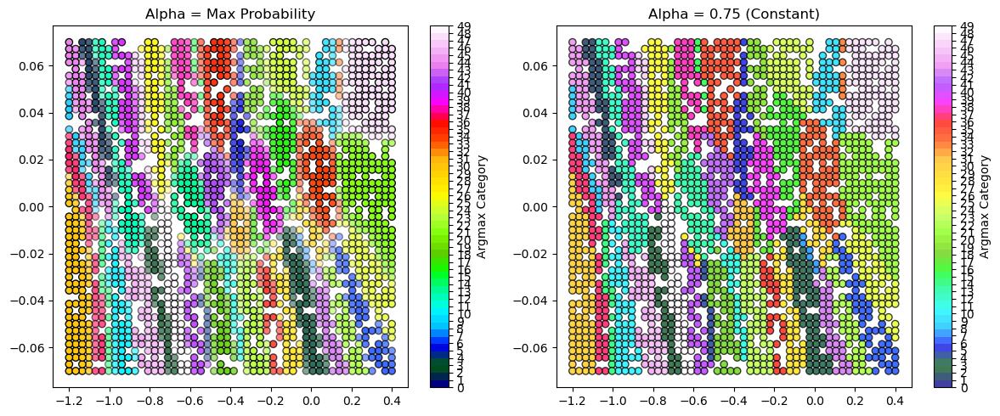

C:\Users\mikef\AppData\Local\Temp\ipykernel_9724\1021837557.py:49: UserWarning:

To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).



In [63]:
#t loss IS  in total loss
discrete_states = 50
learning_rate = 0.001
epochs = 50
auto_weight = 1
transition_weight = 1
decode_weight = 1

tmodel = TransitionModel(discrete_states)
optimizer = optim.Adam(tmodel.parameters(), lr=learning_rate)
train(tmodel, optimizer, train_data, test_data, epochs,N,auto_weight, transition_weight, decode_weight)
print_model(tmodel)
print_example(tmodel, test_data)
plot_categorical_states(train_data, tmodel, discrete_states)
plot_categorical_states_plotly(train_data, tmodel, discrete_states)

Epoch 200/200
Train Loss:         0.037191
Transition Loss:    0.009021
Decode Loss:        0.014577
Auto Encode Loss:   0.013594


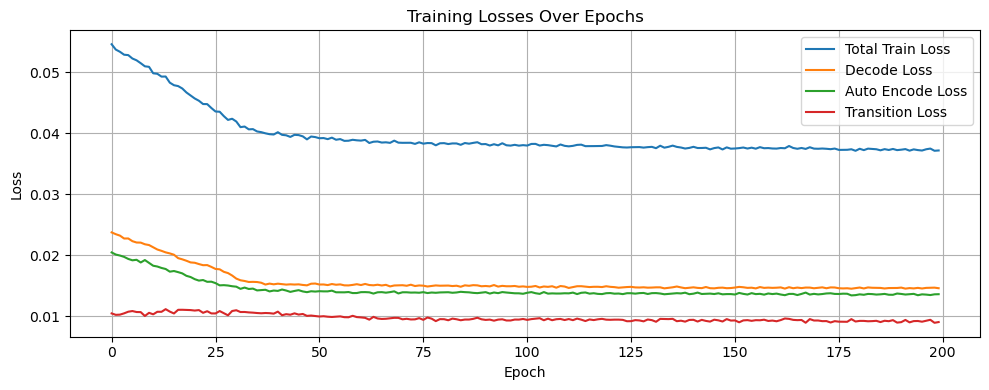

Transition Matrix Action 0
[[1.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.
  0.   0.   0.   0.   0.   0.  ]
 [0.   0.09 0.   0.   0.   0.   0.   0.96 0.   0.   0.   0.   0.   0.
  0.   0.   0.   0.   0.   0.  ]
 [0.   0.   1.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.9
  0.   0.   0.   0.   0.   0.  ]
 [0.   0.   0.   0.06 0.   0.   0.   0.   0.   0.   0.   0.   0.   0.
  0.   0.94 0.   0.   0.   0.  ]
 [0.   0.   0.   0.   0.16 0.   0.   0.   0.   0.   0.   0.   0.   0.
  0.   0.   0.   0.   0.   0.  ]
 [0.   0.   0.   0.   0.   0.07 0.   0.   0.   0.   0.   0.   0.95 0.
  0.   0.   0.   0.   0.   0.02]
 [0.   0.   0.   0.   0.84 0.   0.56 0.   0.   0.   0.   0.   0.   0.
  0.   0.   0.   0.   0.   0.  ]
 [0.   0.   0.   0.   0.   0.   0.   0.04 0.   0.   0.   0.   0.   0.
  0.   0.   0.   0.   0.94 0.  ]
 [0.   0.   0.   0.   0.   0.   0.   0.   0.   0.98 0.   0.   0.   0.
  0.   0.   0.   0.   0.   0.  ]
 [0.   0.   0.   0.   0.   0.   0.44 0.   0. 

C:\Users\mikef\AppData\Local\Temp\ipykernel_8648\1021837557.py:14: UserWarning:

To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).



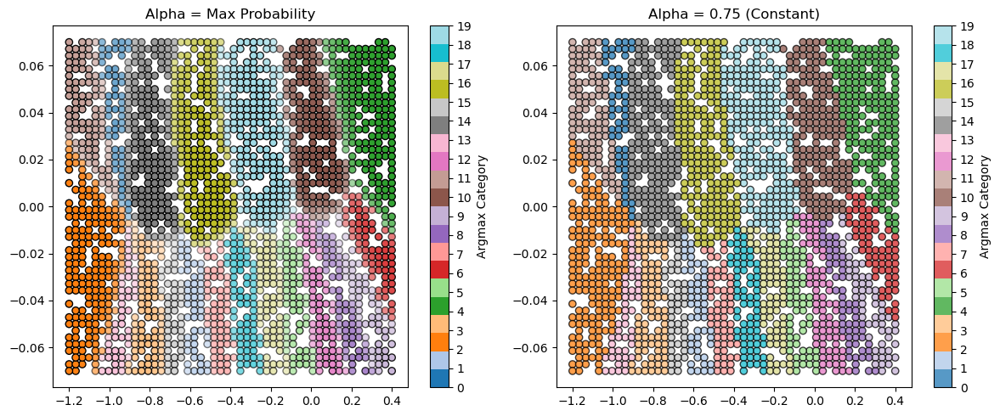

C:\Users\mikef\AppData\Local\Temp\ipykernel_8648\1021837557.py:49: UserWarning:

To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).



In [90]:
train(tmodel, optimizer, train_data, test_data, 200,N,auto_weight, transition_weight, decode_weight)
print_model(tmodel)
print_example(tmodel, test_data)
plot_categorical_states(train_data, tmodel, discrete_states)
plot_categorical_states_plotly(train_data, tmodel, discrete_states)

In [ ]:

#Add softmax to enc(s') for decode

#Kale divergence bw P and P^ bc categorical
#use new decoder for each category and weigh based on the probability 

#decoder is just random initialized matrix
#Try quiver plots again